Data Preprocessing

In [3]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import cv2
from torchvision import transforms
#import matplotlib.patches as patches

def parse_annotation(annotation_line):
    parts = annotation_line.strip().split()
    class_id = int(parts[0])  # The class_id is the first element
    vertices = np.array(parts[1:], dtype=np.float32)  # The rest are the vertices
    return class_id, vertices.reshape((-1, 2))  # Reshape to Nx2 where N is the number of vertices

def draw_polygon_on_mask(mask, corners, image_shape):
    scaled_corners = corners * np.array([image_shape[1], image_shape[0]], dtype=np.float32)  # scale x and y
    scaled_corners = np.around(scaled_corners).astype(np.int32)  # round and convert to int

    # print("Scaled Corners:", scaled_corners)  # Debugging print

    corners_int = scaled_corners.reshape((-1, 1, 2))
    cv2.fillPoly(mask, [corners_int], color=(255))  # Ensure fillPoly is used, not polylines

    # # Debugging visualization
    # plt.imshow(mask, cmap='gray')
    # plt.title('Polygon on Mask')
    # plt.axis('off')
    # plt.show()

def create_mask_from_annotations(annotation_path, image_shape):
    mask = np.zeros((image_shape[0], image_shape[1]), dtype=np.uint8)  # Create a black mask
    with open(annotation_path, 'r') as file:
        for line in file:
            class_id, vertices = parse_annotation(line)
            draw_polygon_on_mask(mask, vertices, image_shape)  # Draw each polygon on the mask
    return mask

def preprocess_image(image_path, annotation_path, target_size):
    # Open and resize image
    image = Image.open(image_path).resize(target_size)
    mask = create_mask_from_annotations(annotation_path, target_size)  # Note the reversal of width and height for the mask
    return np.array(image), mask

# def debug_visualization(image, mask, corners, title='Debug Visualization'):
#     fig, ax = plt.subplots(1, 2, figsize=(10, 5))
#     
#     # Show original image with annotations
#     ax[0].imshow(image)
#     ax[0].set_title(f'{title}: Original Image with Annotations')
#     for corner in corners:
#         scaled_corners = corner * np.array([image.shape[1], image.shape[0]])
#         polygon = patches.Polygon(scaled_corners, linewidth=1, edgecolor='r', facecolor='none')
#         ax[0].add_patch(polygon)
# 
#     # Show mask
#     ax[1].imshow(mask, cmap='gray')
#     ax[1].set_title(f'{title}: Mask')
# 
#     plt.tight_layout()
#     plt.show()

def process_directory(data_dir, annotation_dir, target_size):
    for img_filename in os.listdir(data_dir):
        if img_filename.endswith('.jpg'):
            # Paths for the image and its corresponding annotation file
            image_path = os.path.join(data_dir, img_filename)
            annotation_path = os.path.join(annotation_dir, img_filename.replace('.jpg', '.txt'))

            # Check if the annotation file exists
            if not os.path.isfile(annotation_path):
                print(f"Annotation file does not exist for {image_path}")
                continue  # Skip this image

            # Preprocess the image and create the mask from the annotation
            image, mask = preprocess_image(image_path, annotation_path, target_size)

            # Visualization for debugging
            corners = []  # Store the vertices for debugging visualization
            with open(annotation_path, 'r') as file:
                for line in file:
                    class_id, vertices = parse_annotation(line)
                    corners.append(vertices)

            #debug_visualization(image, mask, corners, title=os.path.basename(image_path))

            # Save the processed image and mask as .npy files
            image_npy_path = os.path.join(data_dir, img_filename.replace('.jpg', '_img.npy'))
            mask_npy_path = os.path.join(data_dir, img_filename.replace('.jpg', '_mask.npy'))

            np.save(image_npy_path, image)
            np.save(mask_npy_path, mask)

def save_as_npy(data_dir, annotation_dir, target_size=(512, 512)):
    processed_data = []
    for img_filename in os.listdir(data_dir):
        if img_filename.endswith('.jpg'):
            image_path = os.path.join(data_dir, img_filename)
            annotation_path = os.path.join(annotation_dir, img_filename.replace('.jpg', '.txt'))
            image, mask = preprocess_image(image_path, annotation_path, target_size)
            np.save(os.path.join(data_dir, img_filename.replace('.jpg', '_img.npy')), image)
            np.save(os.path.join(data_dir, img_filename.replace('.jpg', '_mask.npy')), mask)
            processed_data.append((image, mask))
    print(f"Processed and saved {len(processed_data)} image-mask pairs in .npy format.")

# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# plt.imshow(image)
# plt.title('Processed Image')
# plt.axis('off')
# 
# plt.subplot(1, 2, 2)
# plt.imshow(mask, cmap='gray')
# plt.title('Processed Mask')
# plt.axis('off')
# 
# plt.show()
# Example usage
dataset_base = r'C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb'
partitions = ['train', 'valid', 'test']
target_size = (512, 512)  # Change as required by your model

# Process images and annotations and save them as .npy files
# Process images and annotations
for part in partitions:
    images_dir = os.path.join(dataset_base, part, 'images')
    annotations_dir = os.path.join(dataset_base, part, 'labels')
    process_directory(images_dir, annotations_dir, target_size)
    print(f"Finished processing {part} set")

# Visualization (example for one image from the 'train' set)
train_images_dir = os.path.join(dataset_base, 'train', 'images')
train_image_files = [f for f in os.listdir(train_images_dir) if f.endswith('_img.npy')]

# Load one image and its corresponding mask
image = np.load(os.path.join(train_images_dir, train_image_files[0]))
mask = np.load(os.path.join(train_images_dir, train_image_files[0].replace('_img.npy', '_mask.npy')))

# # Visualize the image and the mask
# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# plt.imshow(image)
# plt.title('Processed Image')
# plt.axis('off')
# 
# plt.subplot(1, 2, 2)
# plt.imshow(mask, cmap='gray')
# plt.title('Processed Mask')
# plt.axis('off')
# 
# plt.show()

Finished processing train set
Finished processing valid set
Finished processing test set



Semantics CNN

In [11]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import cv2

# Define the CNN architecture for segmentation
class SegmentationModel(nn.Module):
    def __init__(self):
        super(SegmentationModel, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, 3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(32, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(64, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, 3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.ConvTranspose2d(64, 32, 3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.ConvTranspose2d(32, 1, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

class PKLotDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.image_files = [f for f in os.listdir(data_dir) if f.endswith('_img.npy')]
        self.transform = transform
        print(f"Found {len(self.image_files)} images in directory {data_dir}")  # Debugging output

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_file = os.path.join(self.data_dir, self.image_files[idx])
        mask_file = image_file.replace('_img.npy', '_mask.npy')

        image = np.load(image_file)
        mask = np.load(mask_file)
        
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask

# Define the evaluation function
def evaluate(model, loader, criterion, device):
    model.eval()
    total_loss = 0.0
    total_correct = 0
    total_pixels = 0

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            preds = outputs > 0.5
            total_loss += loss.item() * images.size(0)
            total_correct += preds.eq(masks).sum().item()
            total_pixels += masks.numel()

    average_loss = total_loss / len(loader.dataset)
    accuracy = total_correct / total_pixels
    return average_loss, accuracy

dataset_base = r'C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb'
partitions = ['train', 'valid', 'test']
target_size = (256, 256)

class DiceLoss(nn.Module):
    def __init__(self, smooth=1.):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, y_pred, y_true):
        assert y_pred.size() == y_true.size()
        y_pred = y_pred.sigmoid()
        y_pred_flat = y_pred.view(-1)
        y_true_flat = y_true.view(-1)
        intersection = (y_pred_flat * y_true_flat).sum()
        dice_coeff = (2. * intersection + self.smooth) / (y_pred_flat.sum() + y_true_flat.sum() + self.smooth)
        return 1 - dice_coeff

# Create datasets and dataloaders for train, validation, and test sets
transform = transforms.Compose([transforms.ToTensor()])

train_dataset = PKLotDataset(os.path.join(dataset_base, 'train', 'images'), transform=transform)
valid_dataset = PKLotDataset(os.path.join(dataset_base, 'valid', 'images'), transform=transform)
test_dataset = PKLotDataset(os.path.join(dataset_base, 'test', 'images'), transform=transform)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Setup device, model, loss function, and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = SegmentationModel().to(device)

criterion = DiceLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

def calculate_accuracy(outputs, masks, threshold=0.5):
    # Apply sigmoid to get probabilities
    probs = torch.sigmoid(outputs)
    # Apply threshold to get binary tensor
    preds = (probs > threshold).float()
    # Calculate accuracy
    correct = (preds == masks).float()
    accuracy = correct.sum() / correct.numel()
    return accuracy.item()

# Initialize lists to store accuracies for each batch
accuracies = []

# Training loop
for epoch in range(50):
    model.train()
    for images, masks in train_loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()
    
    # Evaluate on validation data
    val_loss, val_accuracy = evaluate(model, valid_loader, criterion, device)
    print(f"Epoch {epoch+1}, Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}")

# Save the trained model
torch.save(model.state_dict(), 'segmentation_model.pth')

# Load the trained model for testing
model.load_state_dict(torch.load('segmentation_model.pth'))
model.to(device)

# Evaluate on test data
test_loss, test_accuracy = evaluate(model, test_loader, criterion, device)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")
    

def visualize_predictions(model, loader, device, threshold=0.5, num_images=5):
    model.eval()  # Set the model to evaluation mode
    with torch.no_grad():  # Disable gradient computation
        for images, true_masks in loader:
            images, true_masks = images.to(device), true_masks.to(device)
            preds = model(images)
            preds = torch.sigmoid(preds) > threshold  # Apply threshold to get binary predictions
            
            # Visualize the first `num_images` in the batch
            for i in range(min(num_images, images.size(0))):
                plt.figure(figsize=(20, 6))
                
                plt.subplot(1, 3, 1)
                plt.imshow(images[i].cpu().permute(1, 2, 0))  # Move to CPU and change dimension order for plotting
                plt.title(f'Original Image {i+1}')
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.imshow(true_masks[i].cpu().squeeze(), cmap='gray')  # Move to CPU and remove channel dimension for plotting
                plt.title(f'True Mask {i+1}')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.imshow(preds[i].cpu().squeeze(), cmap='gray')  # Move to CPU and remove channel dimension for plotting
                plt.title(f'Predicted Mask {i+1}')
                plt.axis('off')

                plt.show()

            # Break after the first batch
            break

# Visualize the model's predictions on the test set
visualize_predictions(model, test_loader, device)


Found 8691 images in directory C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb\train\images
Found 2483 images in directory C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb\valid\images
Found 1242 images in directory C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb\test\images


RuntimeError: Given groups=1, weight of size [32, 3, 3, 3], expected input[16, 512, 3, 512] to have 3 channels, but got 512 channels instead

cuda
Found 8691 images in directory C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb\train\images
Found 2483 images in directory C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb\valid\images
Found 1242 images in directory C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb\test\images
Epoch 1: Train Loss = 0.5778, Val Loss = 0.5817, Train Acc = 0.8749, Val Acc = 0.8574
Epoch 2: Train Loss = 0.5777, Val Loss = 0.5812, Train Acc = 0.8770, Val Acc = 0.8958
Epoch 3: Train Loss = 0.5778, Val Loss = 0.5823, Train Acc = 0.8761, Val Acc = 0.8539
Epoch 4: Train Loss = 0.5777, Val Loss = 0.5815, Train Acc = 0.8778, Val Acc = 0.9128
Epoch 5: Train Loss = 0.5776, Val Loss = 0.5812, Train Acc = 0.8783, Val Acc = 0.9011
Epoch 6: Train Loss = 0.5776, Val Loss = 0.5811, Train Acc = 0.8795, Val Acc = 0.8926
Epoch 7: 

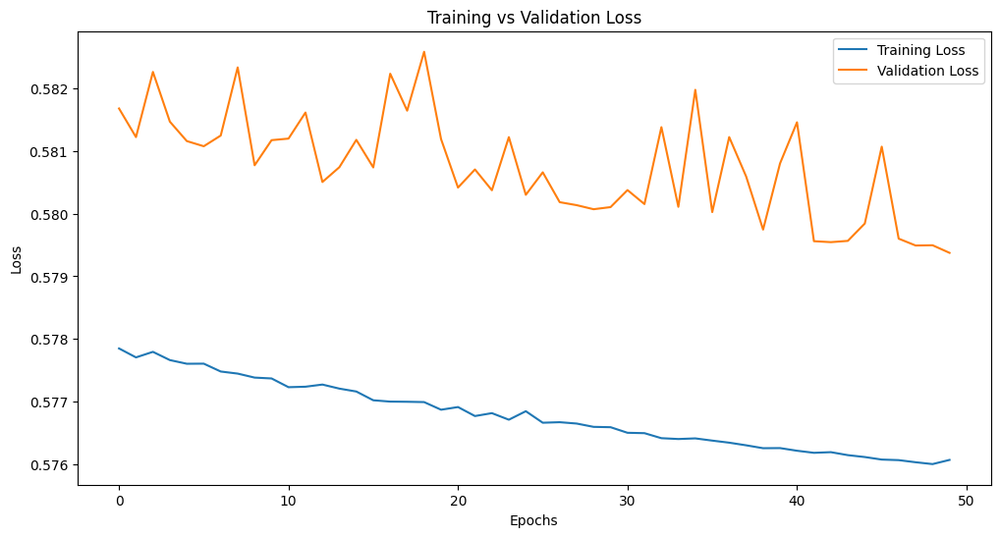

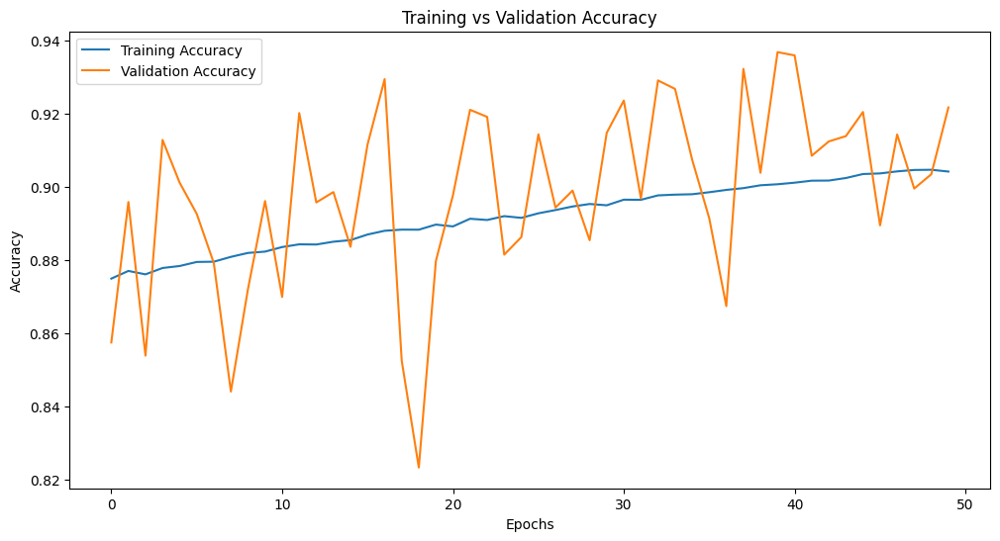

Test Loss: 0.5786, Test Accuracy: 0.9232, Precision: 0.7590, Recall: 0.9828, F1 Score: 0.8565


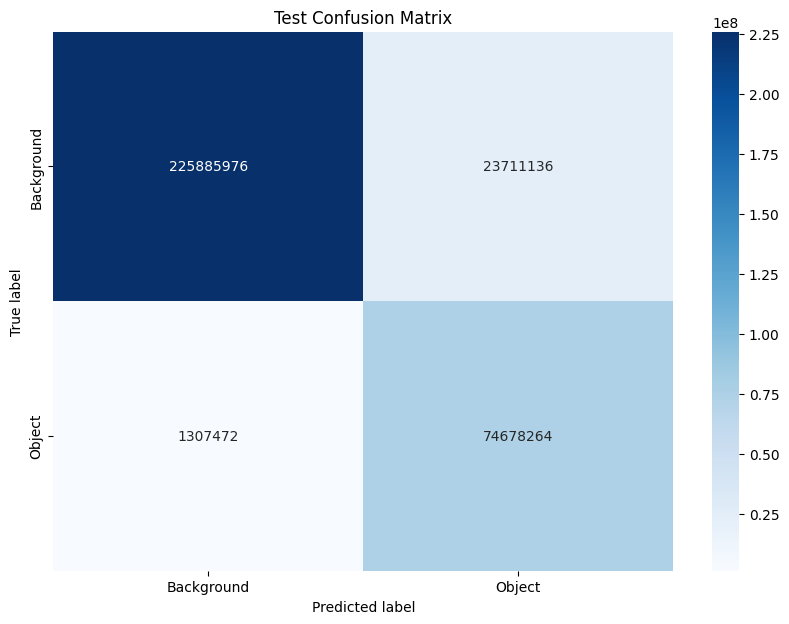

Total Time taken for inference: 7342.6816 seconds


In [22]:
import os
import cv2
import numpy as np
import xml.etree.ElementTree as ET
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.functional as TF
import torch
import torch.nn as nn
import timm
from PIL import Image
import torch.optim as optim
from torchvision import transforms
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import transforms
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support
import seaborn as sns
import time
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

class VisionTransformerForSegmentation(nn.Module):
    def __init__(self, img_size, num_classes):
        super(VisionTransformerForSegmentation, self).__init__()
        # Load a pre-trained Vision Transformer model
        self.vit = timm.create_model('vit_base_patch16_224', pretrained=True, num_classes=0)
        self.decoder = nn.Sequential(
            nn.Conv2d(768, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, num_classes, kernel_size=1)
        )
        self.img_size = img_size

    def forward(self, x):
        # Reshape x to fit ViT input
        B, C, H, W = x.shape
        x = self.vit(x)  # (B, num_patches, embedding_dim)
        x = x.permute(0, 2, 1).view(B, -1, int(H/16), int(W/16))  # reshape to feature map
        x = F.interpolate(x, size=(self.img_size, self.img_size), mode='bilinear', align_corners=False)
        x = self.decoder(x)
        return x
    

class PKLotDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.image_files = [f for f in os.listdir(data_dir) if f.endswith('_img.npy')]
        self.transform = transform
        print(f"Found {len(self.image_files)} images in directory {data_dir}")

    def __len__(self):
        return len(self.image_files)  # This should return the number of items in the dataset

    def __getitem__(self, idx):
        image_file = os.path.join(self.data_dir, self.image_files[idx])
        mask_file = image_file.replace('_img.npy', '_mask.npy')

        image = np.load(image_file)
        mask = np.load(mask_file)
        
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask

# Define the evaluation function
def evaluate(model, loader, criterion, device):
    model.eval()
    total_loss = 0.0
    total_correct = 0
    total_pixels = 0

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            preds = outputs > 0.5
            total_loss += loss.item() * images.size(0)
            total_correct += preds.eq(masks).sum().item()
            total_pixels += masks.numel()

    average_loss = total_loss / len(loader.dataset)
    accuracy = total_correct / total_pixels
    return average_loss, accuracy

dataset_base = r'C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb'
partitions = ['train', 'valid', 'test']
target_size = (512, 512)


# Create datasets and dataloaders for train, validation, and test sets
transform = transforms.Compose([transforms.ToTensor()])

train_dataset = PKLotDataset(os.path.join(dataset_base, 'train', 'images'), transform=transform)
valid_dataset = PKLotDataset(os.path.join(dataset_base, 'valid', 'images'), transform=transform)
test_dataset = PKLotDataset(os.path.join(dataset_base, 'test', 'images'), transform=transform)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# # Setup device, model, loss function, and optimizer
# model = CarNet().to(device)
# criterion = DiceLoss()
# optimizer = optim.Adam(model.parameters(), lr=0.001)

def calculate_accuracy(outputs, masks, threshold=0.5):
    # Apply sigmoid to get probabilities
    probs = torch.sigmoid(outputs)
    # Apply threshold to get binary tensor
    preds = (probs > threshold).float()
    # Calculate accuracy
    correct = (preds == masks).float()
    accuracy = correct.sum() / correct.numel()
    return accuracy.item()

# Initialize lists to store accuracies for each batch
accuracies = []
train_losses = []
valid_losses = []
valid_accuracies = []
train_accuracies = []
start_time = time.time()
# Training loop
for epoch in range(50):
    model.train()
    train_loss = 0
    train_correct = 0
    train_total = 0
    
    for images, masks in train_loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()
        
        train_loss += loss.item() * images.size(0)
        preds = (torch.sigmoid(outputs) > 0.5).float()
        train_correct += (preds == masks).float().sum().item()
        train_total += masks.numel()
    
    train_losses.append(train_loss / len(train_loader.dataset))
    train_accuracies.append(train_correct / train_total)
    
    # Validation step
    model.eval()
    valid_loss = 0
    valid_correct = 0
    valid_total = 0
    with torch.no_grad():
        for images, masks in valid_loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            
            valid_loss += loss.item() * images.size(0)
            preds = (torch.sigmoid(outputs) > 0.5).float()
            valid_correct += (preds == masks).float().sum().item()
            valid_total += masks.numel()
    
    valid_losses.append(valid_loss / len(valid_loader.dataset))
    valid_accuracies.append(valid_correct / valid_total)

    print(f'Epoch {epoch+1}: Train Loss = {train_losses[-1]:.4f}, Val Loss = {valid_losses[-1]:.4f}, Train Acc = {train_accuracies[-1]:.4f}, Val Acc = {valid_accuracies[-1]:.4f}')

# Plotting training vs validation loss
plt.figure(figsize=(12, 6))
plt.plot(train_losses, label='Training Loss')
plt.plot(valid_losses, label='Validation Loss')
plt.title('Training vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plotting training vs validation accuracy
plt.figure(figsize=(12, 6))
plt.plot(train_accuracies, label='Training Accuracy')
plt.plot(valid_accuracies, label='Validation Accuracy')
plt.title('Training vs Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Save the trained model
torch.save(model.state_dict(), 'car_segmentation_model1.pth')

# Load the trained model for testing
model.load_state_dict(torch.load('car_segmentation_model1.pth'))
model.to(device)

def evaluate(model, loader, criterion, device):
    model.eval()
    total_loss = 0.0
    total_correct = 0
    total_pixels = 0
    all_preds = []
    all_true = []

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            preds = (torch.sigmoid(outputs) > 0.5).float()
            
            total_loss += loss.item() * images.size(0)
            total_correct += (preds == masks).float().sum().item()
            total_pixels += masks.numel()

            all_preds.append(preds.view(-1).cpu().numpy())
            all_true.append(masks.view(-1).cpu().numpy())

    average_loss = total_loss / len(loader.dataset)
    accuracy = total_correct / total_pixels
    all_preds = np.concatenate(all_preds)
    all_true = np.concatenate(all_true)
    precision, recall, f1, _ = precision_recall_fscore_support(all_true, all_preds, average='binary')
    cm = confusion_matrix(all_true, all_preds)

    return average_loss, accuracy, precision, recall, f1, cm

# Calculate test metrics and plot confusion matrix
test_loss, test_accuracy, test_precision, test_recall, test_f1, test_cm = evaluate(model, test_loader, criterion, device)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1 Score: {test_f1:.4f}")

def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

plot_confusion_matrix(test_cm, classes=['Background', 'Object'], title='Test Confusion Matrix')
       
end_time = time.time()
inference_time = end_time - start_time
print(f"Total Time taken for inference: {inference_time:.4f} seconds")

In [6]:
import torch
from torchvision import transforms
from torch.utils.data import DataLoader
import timm
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import numpy as np

class VisionTransformerForSegmentation(torch.nn.Module):
    def __init__(self, img_size, num_classes, pretrained_path=None):
        super(VisionTransformerForSegmentation, self).__init__()
        self.vit = timm.create_model(
            'vit_base_patch16_224',
            pretrained=False,  # We're loading our own weights
            num_classes=0,  # This will ignore the classification head
            img_size=img_size
        )
        self.decoder = torch.nn.Sequential(
            torch.nn.Conv2d(768, 128, kernel_size=3, padding=1),
            torch.nn.ReLU(inplace=True),
            torch.nn.Conv2d(128, num_classes, kernel_size=1)
        )
        self.img_size = img_size

        if pretrained_path:
            self.load_pretrained(pretrained_path)

    def forward(self, x):
        B, C, H, W = x.shape
        x = self.vit(x)  # (B, num_patches, embedding_dim)
        x = x.permute(0, 2, 1).view(B, -1, int(H/16), int(W/16))  # reshape to feature map
        x = torch.nn.functional.interpolate(x, size=(self.img_size, self.img_size), mode='bilinear', align_corners=False)
        x = self.decoder(x)
        return x

    def load_pretrained(self, pretrained_path):
        checkpoint = torch.load(pretrained_path, map_location='cpu')
        self.load_state_dict(checkpoint['model'], strict=False)

# Now initialize your model with the correct path to your trained model
model = VisionTransformerForSegmentation(
    img_size=224,  # or the size you used during training
    num_classes=1,  # or the number of classes you have
    pretrained_path='car_segmentation_model.pth'
)
# Load the trained model
model = VisionTransformerForSegmentation(img_size=target_size, num_classes=1)  # Change num_classes if necessary
model.load_state_dict(torch.load('car_segmentation_model.pth'))
model.to(device)
model.eval()

# Define the test dataset and loader
test_dataset = PKLotDataset(os.path.join(dataset_base, 'test', 'images'), transform=transforms.ToTensor())
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to the input size that the model expects
    transforms.ToTensor(),  # Convert image to a tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize the image
])

# Define a function for overlaying the confidence scores on the original image
def overlay_confidence_on_image(original_image, confidence, threshold=0.5):
    overlay = original_image.copy()
    overlay[confidence > threshold] = [255, 0, 0]  # Overlay red where confidence is high
    return overlay

# Visualization loop
for image_path in test_dataset.image_files:  # Replace with actual paths
    # Preprocess the image
    image = Image.open(image_path).convert('RGB')
    image_transformed = transform(image).unsqueeze(0).to(device)  # Add batch dimension and send to device

    # Predict
    with torch.no_grad():
        output = model(image_transformed)
        confidence = torch.sigmoid(output.squeeze(0)).cpu().numpy()

    # Prepare the overlay image
    original_image = np.array(image)
    confidence_resized = cv2.resize(confidence, original_image.shape[1::-1])
    overlay_image = overlay_confidence_on_image(original_image, confidence_resized)

    # Show the overlay image
    plt.imshow(overlay_image)
    plt.show()

    break  # Remove this to process the entire dataset


KeyError: 'model'

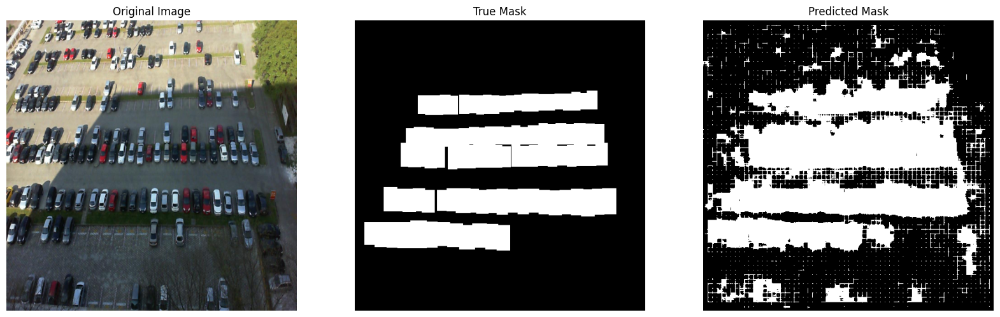

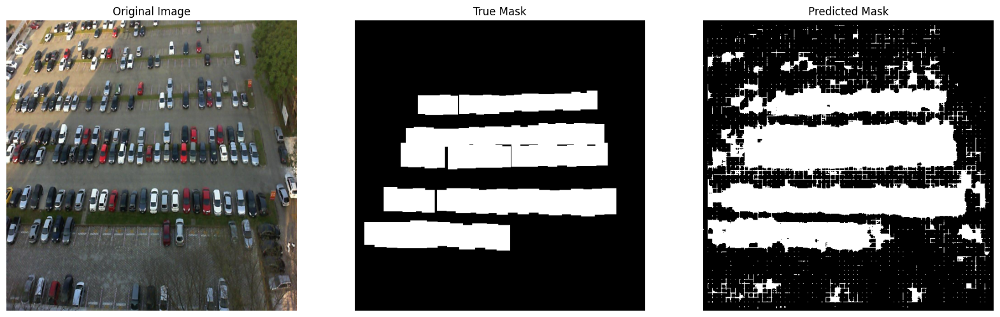

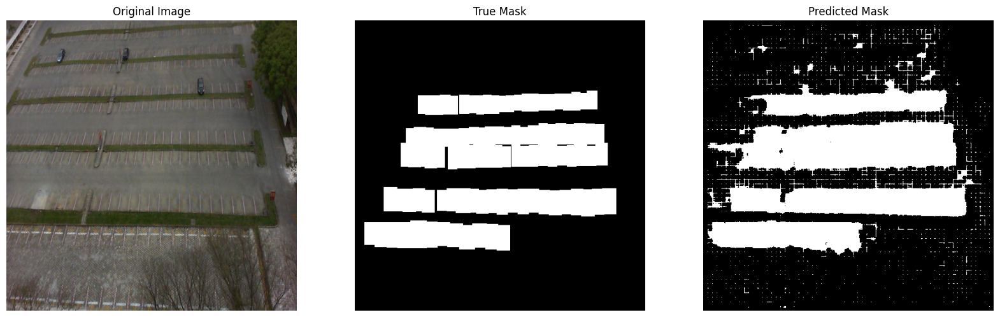

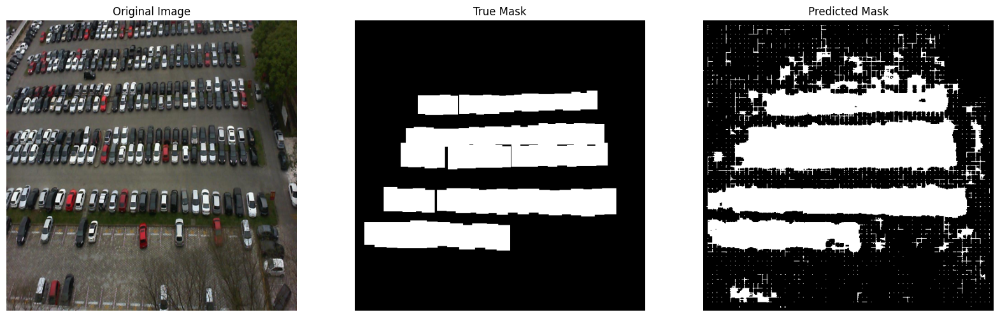

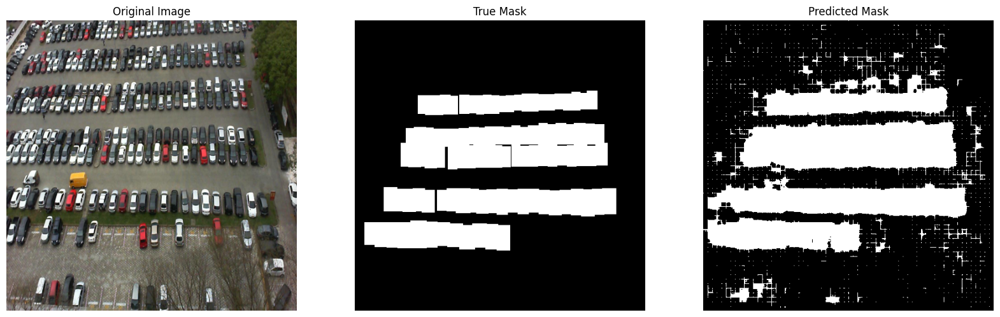

...

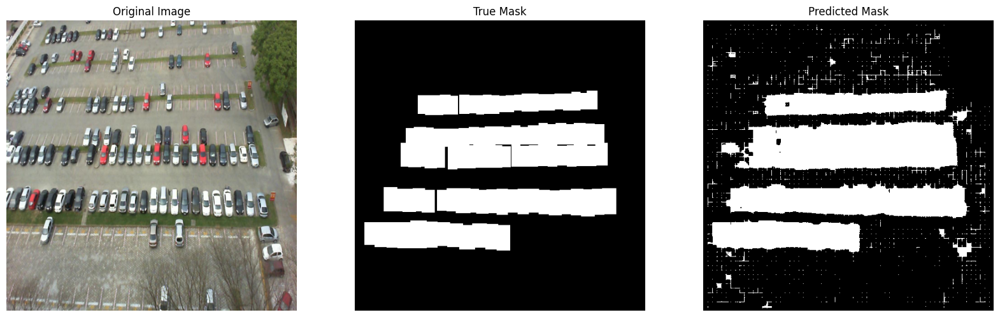

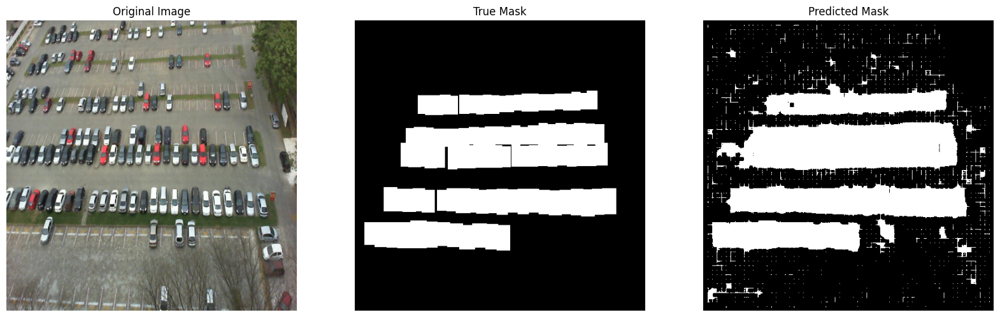

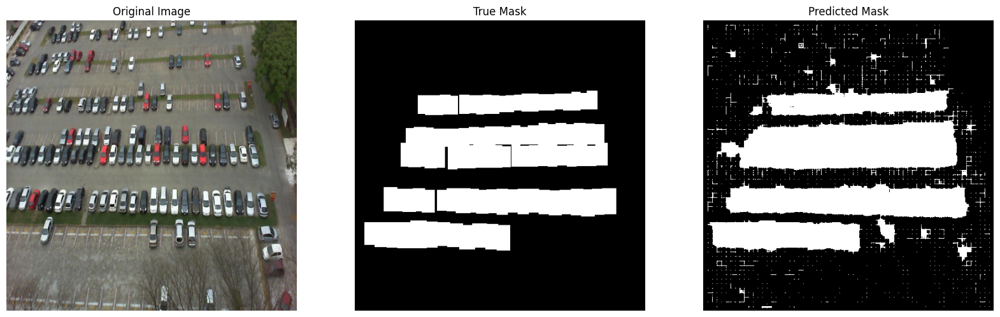

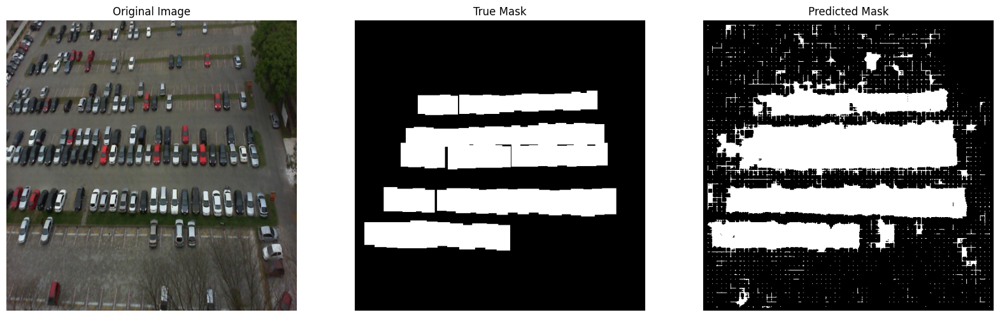

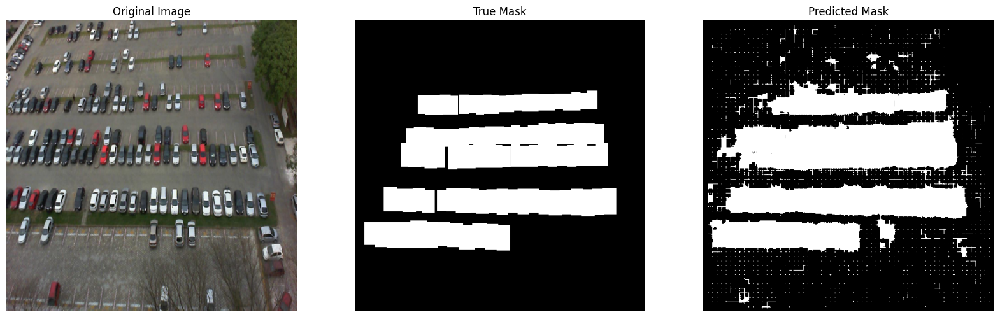

Displayed 36 images from 6 batches.


In [31]:
model_path = 'car_segmentation_model.pth'
model.load_state_dict(torch.load(model_path))
model.to(device)
model.eval()  # Set the model to evaluation mode fo

def visualize_predictions(model, loader, device, threshold=0.5, num_images_per_batch=6, num_batches=6):
    model.eval()  # Set the model to evaluation mode
    images_processed = 0
    batches_processed = 0

    with torch.no_grad():  # Disable gradient computation
        for images, true_masks in loader:
            if batches_processed >= num_batches:
                break  # Stop after the desired number of batches
            
            images, true_masks = images.to(device), true_masks.to(device)
            preds = model(images)
            preds = torch.sigmoid(preds) > threshold  # Apply threshold to get binary predictions

            # Visualize the specified number of images from the current batch
            for i in range(min(num_images_per_batch, images.size(0))):
                fig, axs = plt.subplots(1, 3, figsize=(20, 6))

                # Original Image
                img = images[i].cpu().permute(1, 2, 0).numpy()
                img = (img - img.min()) / (img.max() - img.min())  # Normalize to [0,1]
                axs[0].imshow(img)
                axs[0].set_title('Original Image')
                axs[0].axis('off')

                # True Mask
                axs[1].imshow(true_masks[i].cpu().squeeze(), cmap='gray')
                axs[1].set_title('True Mask')
                axs[1].axis('off')

                # Predicted Mask
                axs[2].imshow(preds[i].cpu().squeeze(), cmap='gray')
                axs[2].set_title('Predicted Mask')
                axs[2].axis('off')

                plt.show()
                images_processed += 1

            batches_processed += 1

    print(f"Displayed {images_processed} images from {batches_processed} batches.")
    
# Example usage
visualize_predictions(model, test_loader, device, threshold=0.5, num_images_per_batch=6, num_batches=6)


In [9]:
import os
import cv2
import numpy as np
import xml.etree.ElementTree as ET
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.functional as TF
import torch
import torch.nn as nn
from PIL import Image
import torch.optim as optim
from torchvision import transforms
import torch.nn.functional as F
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

class DiceLoss(nn.Module):
    def __init__(self, smooth=1.):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, y_pred, y_true):
        assert y_pred.size() == y_true.size()
        y_pred = y_pred.sigmoid()
        y_pred_flat = y_pred.view(-1)
        y_true_flat = y_true.view(-1)
        intersection = (y_pred_flat * y_true_flat).sum()
        dice_coeff = (2. * intersection + self.smooth) / (y_pred_flat.sum() + y_true_flat.sum() + self.smooth)
        return 1 - dice_coeff
    
import torch
import torch.nn as nn

class DoubleConv(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class UNet(nn.Module):
    def __init__(self, in_channels, out_channels, features=[64, 128, 256, 512]):
        super(UNet, self).__init__()
        self.encoder = nn.ModuleList()
        self.decoder = nn.ModuleList()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # Encoder part
        for feature in features:
            self.encoder.append(DoubleConv(in_channels, feature))
            in_channels = feature

        # Decoder part
        for feature in reversed(features):
            self.decoder.append(nn.ConvTranspose2d(feature * 2, feature, kernel_size=2, stride=2))
            self.decoder.append(DoubleConv(feature * 2, feature))

        # Bottleneck part
        self.bottleneck = DoubleConv(features[-1], features[-1] * 2)
        self.final_conv = nn.Conv2d(features[0], out_channels, kernel_size=1)

    def forward(self, x):
        skip_connections = []

        # Encoder
        for down in self.encoder:
            x = down(x)
            skip_connections.append(x)
            x = self.pool(x)

        x = self.bottleneck(x)
        skip_connections = skip_connections[::-1]

        # Decoder
        for idx in range(0, len(self.decoder), 2):
            x = self.decoder[idx](x)
            skip_connection = skip_connections[idx // 2]

            # If the input sizes don't match up, trim the skip_connection on the sides
            if x.shape != skip_connection.shape:
                skip_connection = skip_connection[:, :, :x.shape[2], :x.shape[3]]

            concat_skip = torch.cat((skip_connection, x), dim=1)
            x = self.decoder[idx + 1](concat_skip)

        return self.final_conv(x)

# Example of creating a U-Net model
model = UNet(in_channels=3, out_channels=1).to(device)

print(model)


class PKLotDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.image_files = [f for f in os.listdir(data_dir) if f.endswith('_img.npy')]
        self.transform = transform
        print(f"Found {len(self.image_files)} images in directory {data_dir}")  # Debugging output

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_file = os.path.join(self.data_dir, self.image_files[idx])
        mask_file = image_file.replace('_img.npy', '_mask.npy')

        image = np.load(image_file)
        mask = np.load(mask_file)
        
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask

# Define the evaluation function
def evaluate(model, loader, criterion, device):
    model.eval()
    total_loss = 0.0
    total_correct = 0
    total_pixels = 0

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            preds = outputs > 0.5
            total_loss += loss.item() * images.size(0)
            total_correct += preds.eq(masks).sum().item()
            total_pixels += masks.numel()

    average_loss = total_loss / len(loader.dataset)
    accuracy = total_correct / total_pixels
    return average_loss, accuracy

dataset_base = r'C:/Users/SirM/Desktop/Swayam/Intro to Deep Learning/Intro-to-Deep-Learning/Final Project/PKLot.v1-raw.yolov8-obb'
partitions = ['train', 'valid', 'test']
target_size = (128, 128)

class DiceLoss(nn.Module):
    def __init__(self, smooth=1.):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, y_pred, y_true):
        assert y_pred.size() == y_true.size()
        y_pred = y_pred.sigmoid()
        y_pred_flat = y_pred.view(-1)
        y_true_flat = y_true.view(-1)
        intersection = (y_pred_flat * y_true_flat).sum()
        dice_coeff = (2. * intersection + self.smooth) / (y_pred_flat.sum() + y_true_flat.sum() + self.smooth)
        return 1 - dice_coeff

# Create datasets and dataloaders for train, validation, and test sets
transform = transforms.Compose([transforms.ToTensor()])

train_dataset = PKLotDataset(os.path.join(dataset_base, 'train', 'images'), transform=transform)
valid_dataset = PKLotDataset(os.path.join(dataset_base, 'valid', 'images'), transform=transform)
test_dataset = PKLotDataset(os.path.join(dataset_base, 'test', 'images'), transform=transform)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)

# Setup device, model, loss function, and optimizer
# model = 
# criterion = DiceLoss()
# optimizer = optim.Adam(model.parameters(), lr=0.001)

def calculate_accuracy(outputs, masks, threshold=0.5):
    # Apply sigmoid to get probabilities
    probs = torch.sigmoid(outputs)
    # Apply threshold to get binary tensor
    preds = (probs > threshold).float()
    # Calculate accuracy
    correct = (preds == masks).float()
    accuracy = correct.sum() / correct.numel()
    return accuracy.item()

# Initialize lists to store accuracies for each batch
accuracies = []

num_epochs = 50  # Change number of epochs if necessary
for epoch in range(num_epochs):
    model.train()
    for images, masks in train_loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()
    
    # Evaluate on validation data
    val_loss, val_accuracy = evaluate(model, valid_loader, criterion, device)
    print(f"Epoch {epoch+1}, Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}")

# Save the model after training
torch.save(model.state_dict(), 'segmentation_model.pth')

# Load the model for testing
model.load_state_dict(torch.load('segmentation_model.pth'))
model.to(device)

# Evaluate on test data
test_loss, test_accuracy = evaluate(model, test_loader, criterion, device)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")

# Define the visualization function
def visualize_predictions(model, loader, device, threshold=0.5, num_images=5):
    model.eval()  # Set the model to evaluation mode
    with torch.no_grad():  # Disable gradient computation
        for images, true_masks in loader:
            images, true_masks = images.to(device), true_masks.to(device)
            preds = model(images)
            preds = torch.sigmoid(preds) > threshold  # Apply threshold to get binary predictions
            
            # Visualize the first `num_images` in the batch
            for i in range(min(num_images, images.size(0))):
                plt.figure(figsize=(20, 6))
                
                plt.subplot(1, 3, 1)
                plt.imshow(images[i].cpu().permute(1, 2, 0))  # Move to CPU and change dimension order for plotting
                plt.title(f'Original Image {i+1}')
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.imshow(true_masks[i].cpu().squeeze(), cmap='gray')  # Move to CPU and remove channel dimension for plotting
                plt.title(f'True Mask {i+1}')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.imshow(preds[i].cpu().squeeze(), cmap='gray')  # Move to CPU and remove channel dimension for plotting
                plt.title(f'Predicted Mask {i+1}')
                plt.axis('off')

                plt.show()

            # Break after the first batch
            break

cuda
UNet(
  (encoder): ModuleList(
    (0): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
    (1): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
    (2):

KeyboardInterrupt: 